# 3. Fitting diads once you have groups
- Once you have divided your diads into groups based on strengths, you need to tweak the fit parameters for each group
- Then you can loop through all files in a given group and automatically fit the spectra

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import joblib
import DiadFit as pf
pf.__version__

'0.0.90'

## Specifying filetype, and folder as before

In [2]:
# This specifies what file type your Raman exported in. 
meta_path, spectra_path, spectra_filetype, prefix, str_prefix, spectra_file_ext, meta_file_ext, TruPower=pf.get_settings()

## Load in data and fit parameters
- This loads in the dataframes of the fit parameters you saved in the other file, by group
- At this point you select what group you want to fit (batch = 'Weak', 'Medium' or 'Strong'). After running through the entire notebook for one group, come back up here to fit a second group.

In [3]:
## load dataframes and numpy arrays 
np_x = joblib.load('np_x.sav')

# Select the group you want to fit ('Weak', 'Medium', 'Strong'). After selecting one, go through and select another one and run again from here. 
batch='Weak' # Options are Weak, Medium, Strong

if batch=='Weak':
    GroupN_df=joblib.load('Weak_df.sav')
if batch=='Medium':
    GroupN_df=joblib.load('Medium_df.sav')
if batch=='Strong':
    GroupN_df=joblib.load('Strong_df.sav')

### Now load one file from this group to tweak parameters for

In [4]:
Diad_Files =GroupN_df['filename']
i=0


### Lets plot the diad to have a look at it

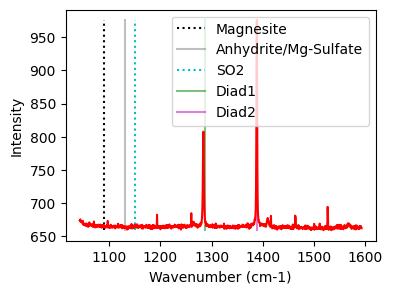

In [5]:
plot1=pf.plot_diad(path=spectra_path, filename=Diad_Files[i], filetype=spectra_filetype)

## Now lets inspect the diads and get their approximate positions
- As with generic peak, you can exclude 2 segments (e.g. around cosmic rays)
- You then specify how many peaks you want to fit on each diad. 1 means just the strong peak, 2 hotbands, and 3 for Diad2 would also fit the C13 peak if present. 
- The identify_diad_peaks then uses scipy findpeaks to identify the positions of the 2 diads, and any other peaks the user asks for. These are saved, and fed into the later functions for peak fitting. 

## Choose a model for fitting all peaks
- Option of Voigt or PseudoVoigt. We recomend PsuedoVoigt

In [6]:
model_name='PseudoVoigtModel'

## Fit Diad 1
- Tweak the parameters in the config files for each group. E.g. how many peaks (fit_peaks), the background positions, the sigma of the diad, and whether or not you want a gaussian background

In [7]:
diad_id_config=pf.diad_id_config(height=50, exclude_range1=[1308, 1309])
diad_id_config

if batch=='Weak':
    diad1_fit_config_init=pf.diad1_fit_config(
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1250),
    upper_bck_diad1=(1300, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=100, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
    diad1_fit_config_init

if batch=='Medium':
    diad1_fit_config_init=pf.diad1_fit_config(
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=2, lower_bck_diad1=(1180, 1240),
    upper_bck_diad1=(1315, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=100, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
    diad1_fit_config_init

if batch=='Strong':
    diad1_fit_config_init=pf.diad1_fit_config(
    fit_gauss=True, gauss_amp= 2*GroupN_df['HB1_abs_prom'].iloc[i],
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1220),
    upper_bck_diad1=(1330, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=1000, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
diad1_fit_config_init

diad1_fit_config(model_name='PseudoVoigtModel', fit_peaks=2, N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1250), upper_bck_diad1=(1300, 1350), fit_gauss=False, gauss_amp=1000, diad_sigma=0.6, diad_sigma_min_allowance=0.2, diad_sigma_max_allowance=5, diad_prom=150.39622641959863, HB_prom=nan, x_range_baseline=30, y_range_baseline=100, dpi=200, x_range_residual=10, return_other_params=False)

### See what these fit parameters look like for diad1

,Diad1_Combofit_Cent,Diad1_Voigt_Cent,Diad1_cent_err,Diad1_Voigt_Area,Diad1_Voigt_Sigma,Diad1_Voigt_Gamma,Diad1_Combofit_Height,Diad1_Residual,Diad1_Prop_Lor,Diad1_fwhm,Diad1_refit,Diad1_Asym50,Diad1_Asym70,Diad1_Yuan2017_sym_factor,Diad1_Remigi2021_BSF,Diad1_PDF_Model
0,1283.71791,1283.71791,0.012908,450.978847,1.067749,0,151.526101,1.876613,0.732861,2.135498,Flagged Warnings:,1.033654,1.014574,0.071868,0.014093,PseudoVoigtModel


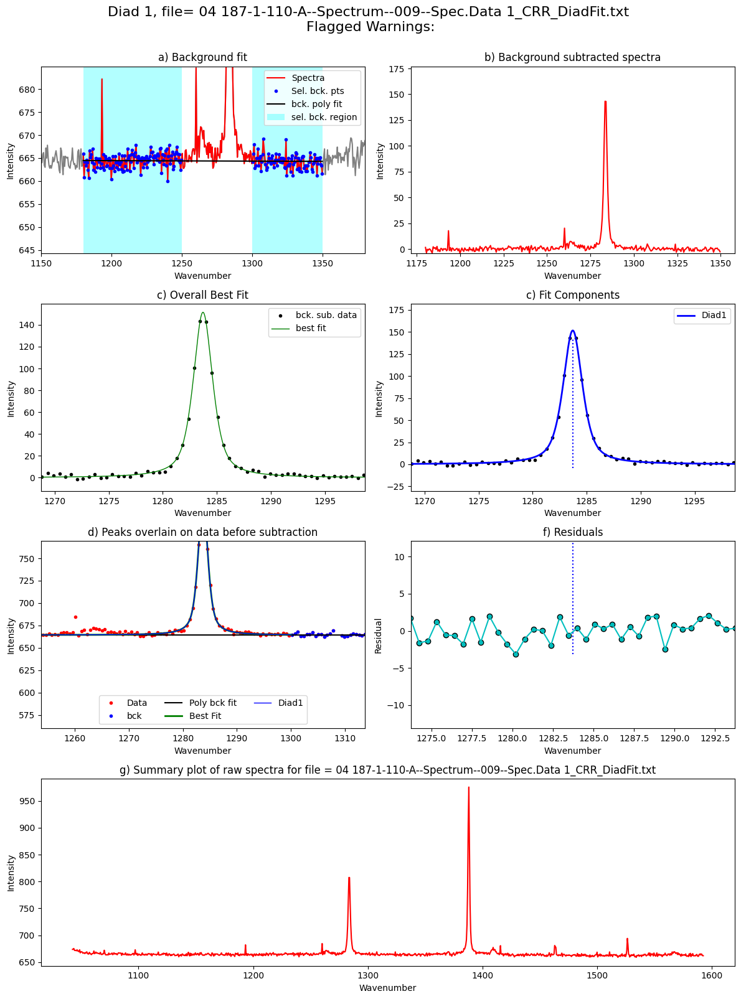

In [8]:
Diad1_fit=pf.fit_diad_1_w_bck(config1=diad1_fit_config_init,
config2=diad_id_config,
path=spectra_path, filename=Diad_Files.iloc[0],
filetype=spectra_filetype, plot_figure=True, close_figure=False,
Diad_pos=GroupN_df['Diad1_pos'].iloc[i],
HB_pos=GroupN_df['HB1_pos'].iloc[i])
Diad1_fit

### Update the sigma
- The sigma parameter varies quite a lot based on the splitting. Best to update your first guess with what you found for the example file above

In [9]:
diad1_fit_config2=diad1_fit_config_init

## Fit diad2

In [10]:
if batch=='Weak':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=2, upper_bck_diad2=(1430, 1480),
    lower_bck_diad2=(1310, 1360), diad_sigma=0.4,  N_poly_bck_diad2=2,                                       
    x_range_residual=30, y_range_baseline=100,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i])
    diad2_fit_config_init

if batch=='Medium':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=3, fit_gauss=True, gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i],
    lower_bck_diad2=(1310, 1350), diad_sigma=1,  N_poly_bck_diad2=2,                                       
    x_range_residual=30, y_range_baseline=100,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i],
    C13_prom=GroupN_df['C13_abs_prom'].iloc[i])
    diad2_fit_config_init

if batch=='Strong':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=3, fit_gauss=True, gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i],
    lower_bck_diad2=(1310, 1340), diad_sigma=1,  N_poly_bck_diad2=2,                                       
    x_range_residual=30, y_range_baseline=1000,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i],
    C13_prom=GroupN_df['C13_abs_prom'].iloc[i])
    diad2_fit_config_init
diad2_fit_config_init

diad2_fit_config(model_name='PseudoVoigtModel', fit_peaks=2, N_poly_bck_diad2=2, lower_bck_diad2=(1310, 1360), upper_bck_diad2=(1430, 1480), fit_gauss=False, gauss_amp=1000, diad_sigma=0.4, diad_sigma_min_allowance=0.2, diad_sigma_max_allowance=5, diad_prom=312.908659122832, HB_prom=nan, C13_prom=10, x_range_baseline=30, y_range_baseline=100, plot_figure=True, dpi=200, x_range_residual=30, return_other_params=False)

### See what these fit parameters look like for diad2

,Diad2_Combofit_Cent,Diad2_Voigt_Cent,Diad2_cent_err,Diad2_Voigt_Area,Diad2_Voigt_Sigma,Diad2_Voigt_Gamma,Diad2_Combofit_Height,Diad2_Residual,Diad2_Prop_Lor,Diad2_fwhm,Diad2_refit,Diad2_Asym50,Diad2_Asym70,Diad2_Yuan2017_sym_factor,Diad2_Remigi2021_BSF,Diad2_PDF_Model
0,1387.953049,1387.953049,0.00627,710.687423,0.812486,0,314.325369,2.222357,0.728951,1.624972,Flagged Warnings:,1.087983,1.085627,0.14297,0.00517,PseudoVoigtModel


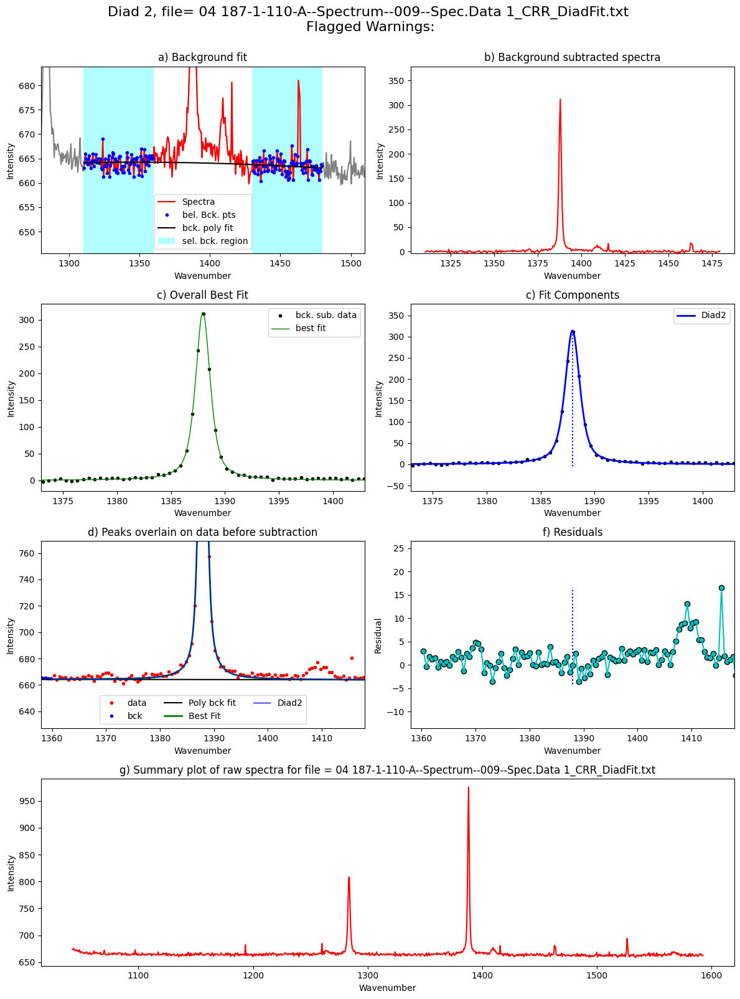

In [11]:
Diad2_fit=pf.fit_diad_2_w_bck(config1=diad2_fit_config_init,
    config2=diad_id_config,
path=spectra_path, filename=Diad_Files[i], filetype=spectra_filetype,
plot_figure=True, close_figure=False, 
Diad_pos=GroupN_df['Diad2_pos'].iloc[i],
HB_pos=GroupN_df['HB2_pos'].iloc[i], 
C13_pos=GroupN_df['C13_pos'].iloc[i])
Diad2_fit.to_clipboard(excel=True)
Diad2_fit

## Loop over all the files in the group
- This will loop over all the 

  0%|          | 0/34 [00:00<?, ?it/s]

Processing file: 04 187-1-110-A--Spectrum--009--Spec.Data 1_CRR_DiadFit.txt


  3%|▎         | 1/34 [00:03<01:52,  3.41s/it]

Processing file: 05 187-1-110-A--Spectrum--010--Spec.Data 1_CRR_DiadFit.txt


  6%|▌         | 2/34 [00:06<01:47,  3.36s/it]

Processing file: 06 187-1-110-A--Spectrum--011--Spec.Data 1_CRR_DiadFit.txt


  9%|▉         | 3/34 [00:09<01:42,  3.31s/it]

Processing file: 08 187-1-110-B--Spectrum--014--Spec.Data 1_CRR_DiadFit.txt


 12%|█▏        | 4/34 [00:13<01:40,  3.33s/it]

Processing file: 09 187-1-110-B--Spectrum--015--Spec.Data 1.txt


 15%|█▍        | 5/34 [00:16<01:39,  3.44s/it]

Processing file: 10 187-1-110-B--Spectrum--016--Spec.Data 1.txt


 18%|█▊        | 6/34 [00:20<01:39,  3.54s/it]

Processing file: 12 187-1-110-C--Spectrum--020--Spec.Data 1_CRR_DiadFit.txt


 21%|██        | 7/34 [00:24<01:39,  3.68s/it]

Processing file: 13 187-1-110-C--Spectrum--021--Spec.Data 1_CRR_DiadFit.txt


 24%|██▎       | 8/34 [00:28<01:40,  3.85s/it]

Processing file: 14 187-1-110-C--Spectrum--022--Spec.Data 1.txt


 26%|██▋       | 9/34 [00:33<01:38,  3.95s/it]

Processing file: 17 187-1-111-reg1-A--Spectrum--031--Spec.Data 1_CRR_DiadFit.txt


 29%|██▉       | 10/34 [00:37<01:38,  4.09s/it]

Processing file: 18 187-1-111-reg1-A--Spectrum--032--Spec.Data 1_CRR_DiadFit.txt


c:\users\charl\documents\python dev\diadfit\src\DiadFit\diads.py:3106: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,axes=plt.subplot_mosaic(mosaic=figure_mosaic, figsize=(12, 16))
 32%|███▏      | 11/34 [00:41<01:34,  4.11s/it]

Processing file: 20 187-1-111-reg1-A--Spectrum--034--Spec.Data 1_CRR_DiadFit.txt


 35%|███▌      | 12/34 [00:45<01:26,  3.92s/it]

Processing file: 22 187-1-111-reg1-A--Spectrum--036--Spec.Data 1_CRR_DiadFit.txt


 38%|███▊      | 13/34 [00:48<01:21,  3.87s/it]

Processing file: 23 187-1-111-reg1-B--Spectrum--038--Spec.Data 1.txt


 41%|████      | 14/34 [00:51<01:12,  3.64s/it]

Processing file: 24 187-1-111-reg1-B--Spectrum--039--Spec.Data 1_CRR_DiadFit.txt


 44%|████▍     | 15/34 [00:54<01:05,  3.43s/it]

Processing file: 25 187-1-111-reg1-B--Spectrum--040--Spec.Data 1.txt


 47%|████▋     | 16/34 [00:58<01:00,  3.36s/it]

Processing file: 26 187-1-111-reg1-C--Spectrum--043--Spec.Data 1_CRR_DiadFit.txt


 50%|█████     | 17/34 [01:01<00:56,  3.31s/it]

Processing file: 27 187-1-111-reg1-C--Spectrum--044--Spec.Data 1.txt


 53%|█████▎    | 18/34 [01:04<00:51,  3.20s/it]

Processing file: 29 187-1-111-reg2-A--Spectrum--047--Spec.Data 1.txt


 56%|█████▌    | 19/34 [01:07<00:47,  3.17s/it]

Processing file: 30 187-1-111-reg2-A--Spectrum--048--Spec.Data 1.txt


 59%|█████▉    | 20/34 [01:10<00:43,  3.08s/it]

Processing file: 31 187-1-111-reg2-A--Spectrum--049--Spec.Data 1.txt


 62%|██████▏   | 21/34 [01:13<00:39,  3.02s/it]

Processing file: 33 187-1-111-reg2-B--Spectrum--052--Spec.Data 1.txt


 65%|██████▍   | 22/34 [01:16<00:35,  2.99s/it]

Processing file: 34 187-1-111-reg2-B--Spectrum--053--Spec.Data 1.txt


 68%|██████▊   | 23/34 [01:19<00:34,  3.12s/it]

Processing file: 35 187-1-111-reg2-B--Spectrum--054--Spec.Data 1.txt


 71%|███████   | 24/34 [01:22<00:30,  3.04s/it]

Processing file: 38 187-1-111-reg3-A--Spectrum--060--Spec.Data 1.txt


 74%|███████▎  | 25/34 [01:25<00:28,  3.13s/it]

Processing file: 39 187-1-111-reg3-A--Spectrum--061--Spec.Data 1_CRR_DiadFit.txt


 76%|███████▋  | 26/34 [01:28<00:25,  3.13s/it]

Processing file: 41 187-1-111-reg3-B--Spectrum--064--Spec.Data 1_CRR_DiadFit.txt


 79%|███████▉  | 27/34 [01:32<00:22,  3.16s/it]

Processing file: 42 187-1-111-reg3-B--Spectrum--065--Spec.Data 1.txt


 82%|████████▏ | 28/34 [01:35<00:18,  3.16s/it]

Processing file: 43 187-1-111-reg3-B--Spectrum--066--Spec.Data 1.txt


 85%|████████▌ | 29/34 [01:38<00:16,  3.34s/it]

Processing file: 45 187-1-111-reg3-C--Spectrum--070--Spec.Data 1_CRR_DiadFit.txt


 88%|████████▊ | 30/34 [01:42<00:13,  3.35s/it]

Processing file: 46 187-1-111-reg3-C--Spectrum--071--Spec.Data 1.txt


 91%|█████████ | 31/34 [01:45<00:10,  3.38s/it]

Processing file: 47 187-1-111-reg3-C--Spectrum--072--Spec.Data 1_CRR_DiadFit.txt


 94%|█████████▍| 32/34 [01:49<00:06,  3.45s/it]

Processing file: 49 187-1-111-reg4-A--Spectrum--078--Spec.Data 1.txt


 97%|█████████▋| 33/34 [01:52<00:03,  3.37s/it]

Processing file: 50 187-1-111-reg4-A--Spectrum--079--Spec.Data 1.txt


100%|██████████| 34/34 [01:55<00:00,  3.40s/it]


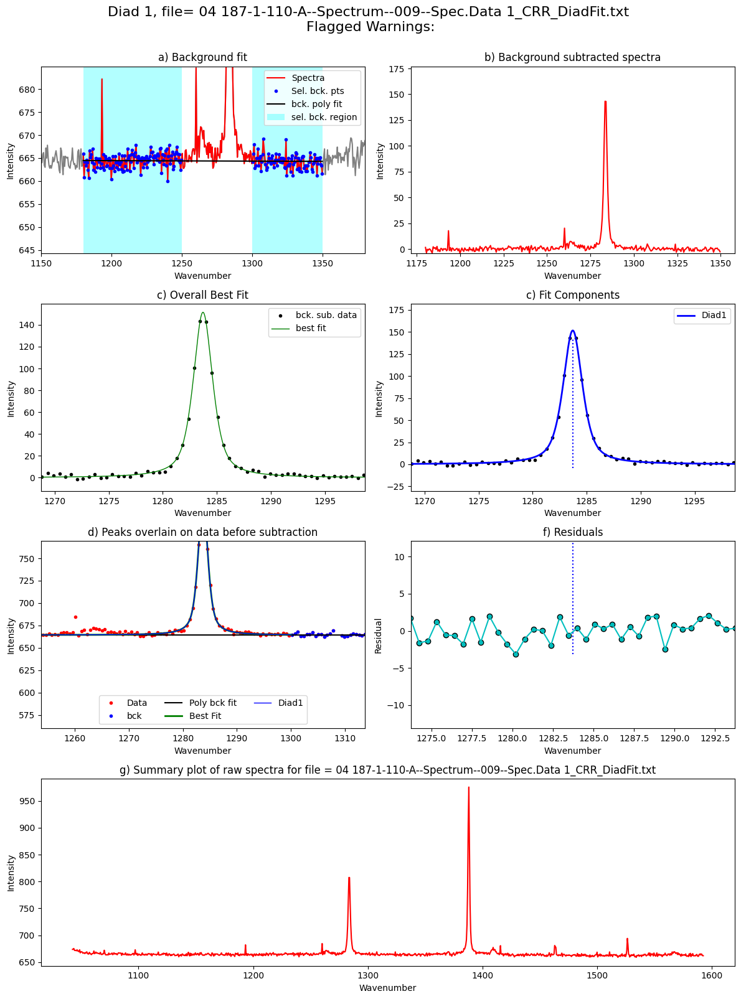

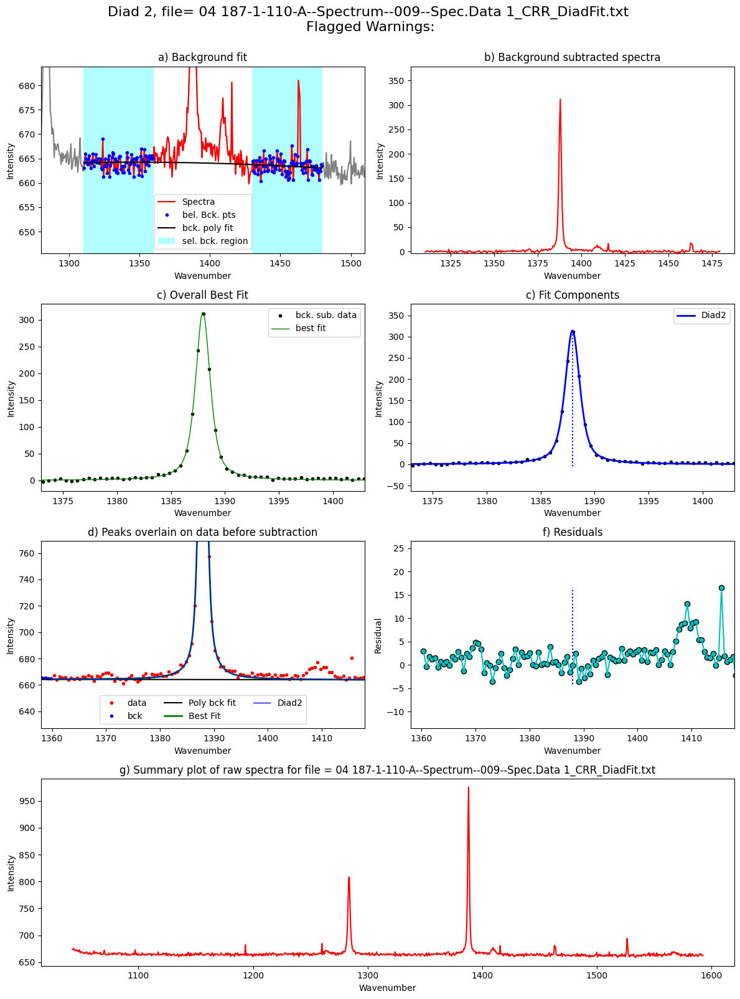

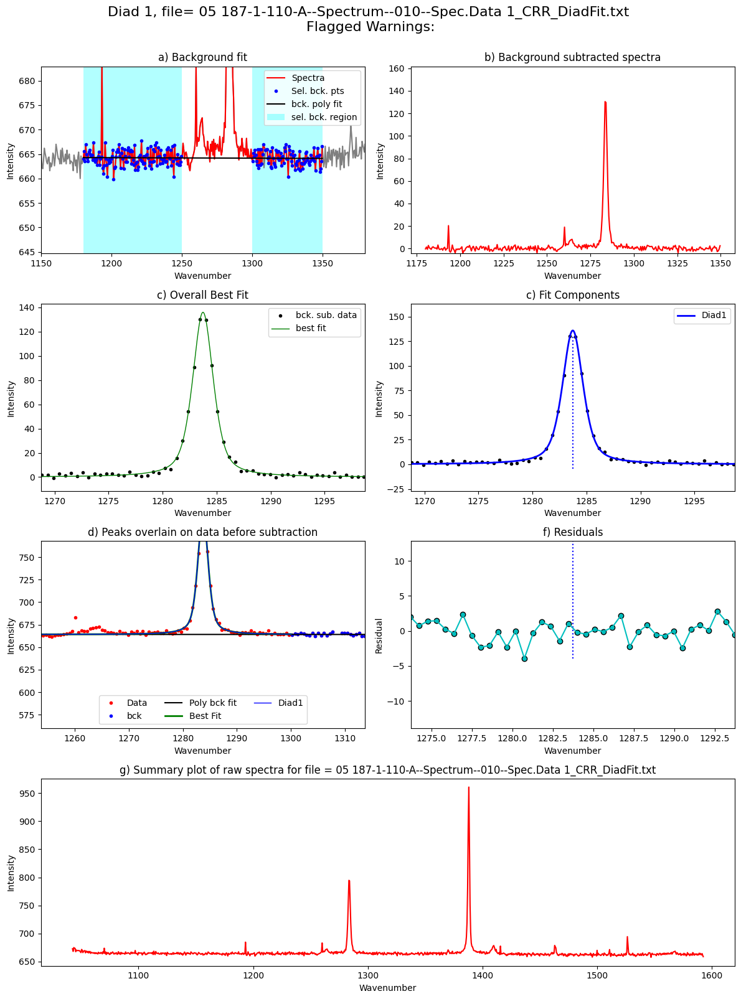

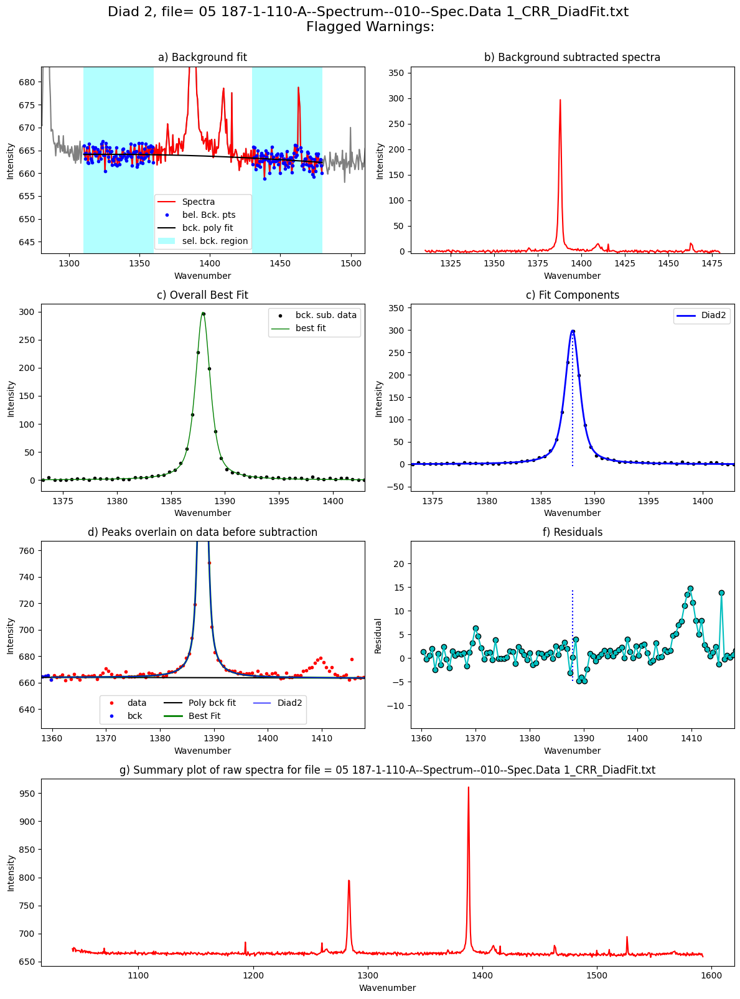

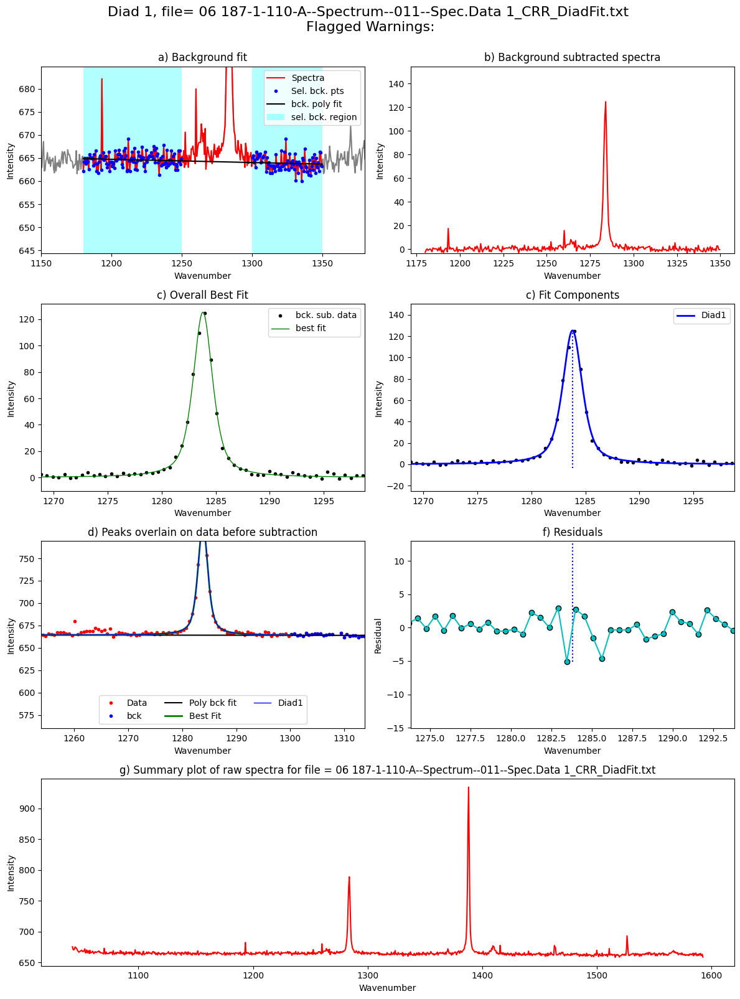

...

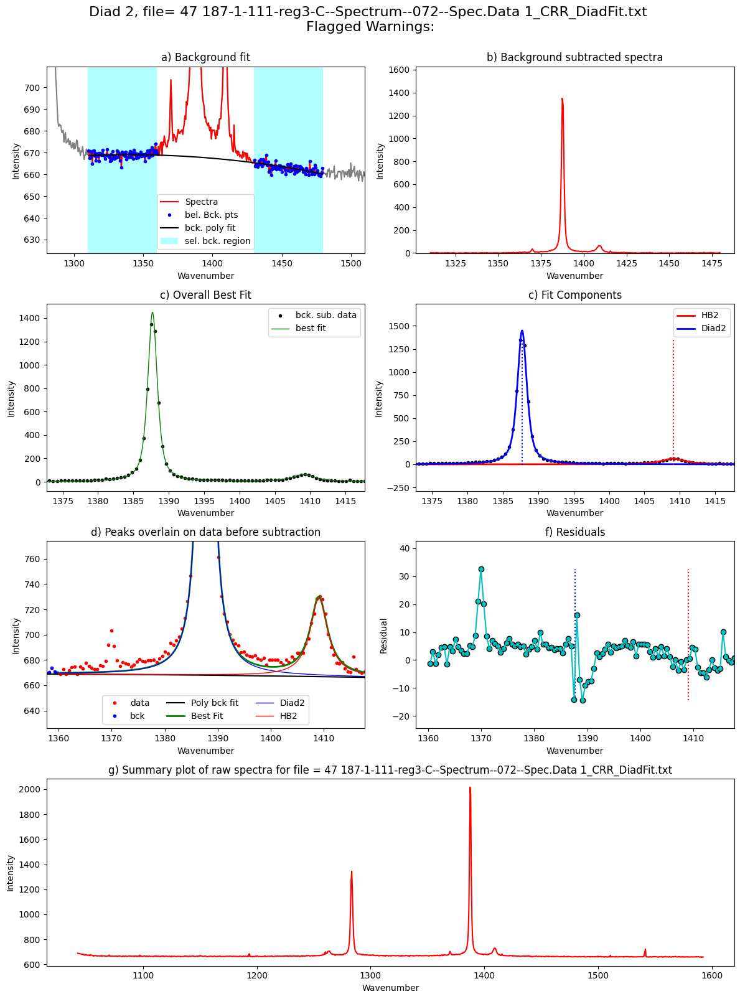

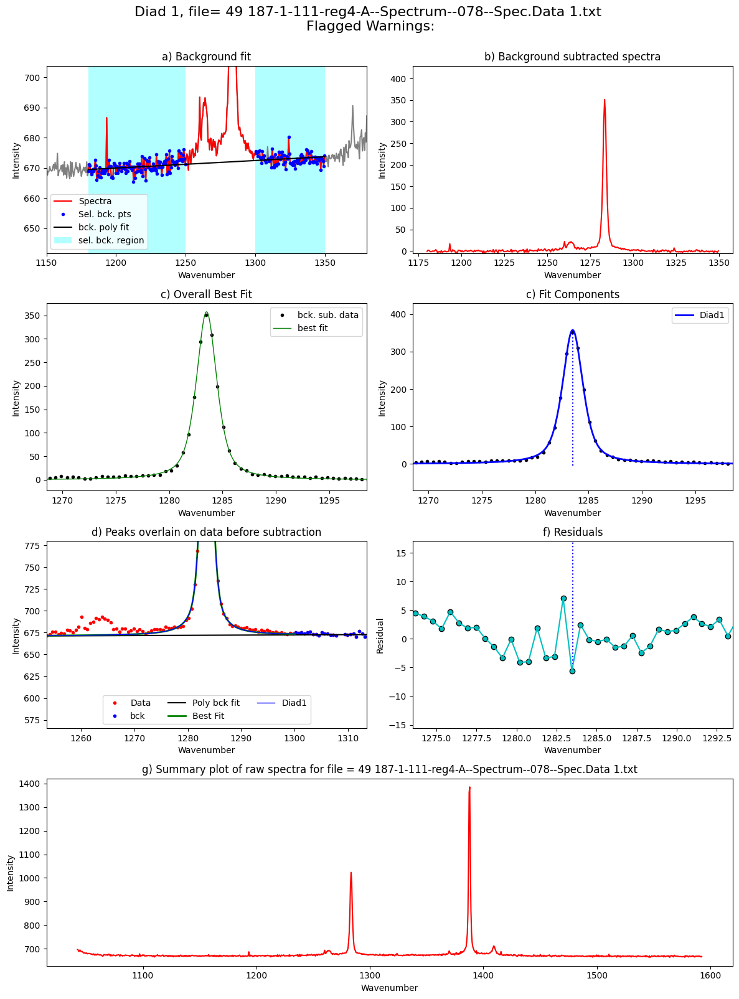

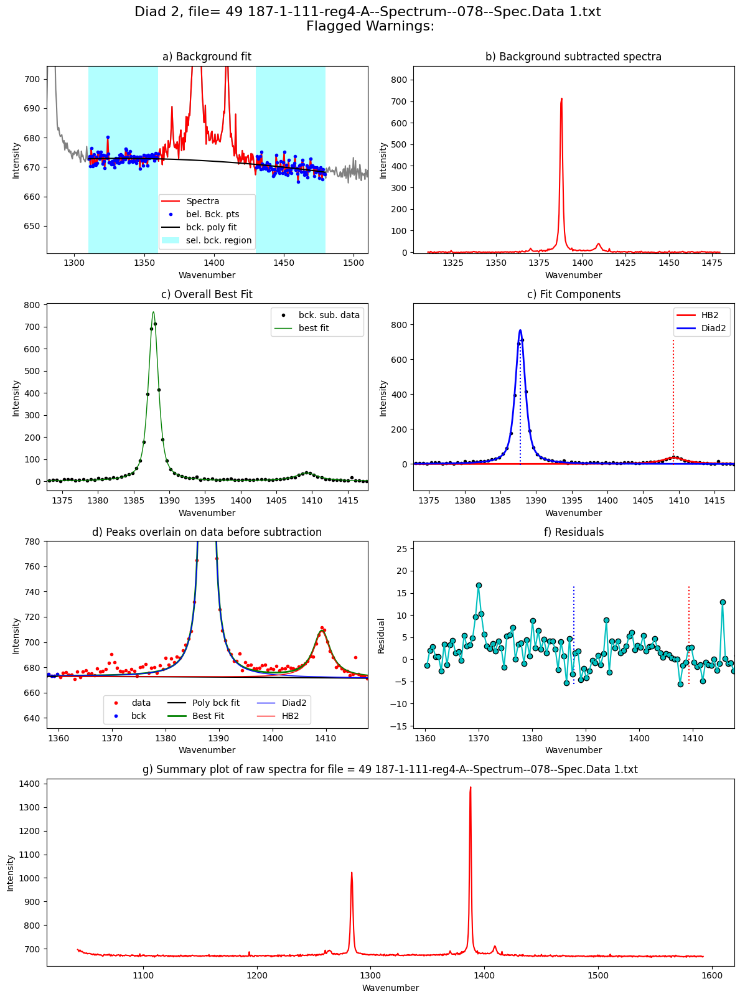

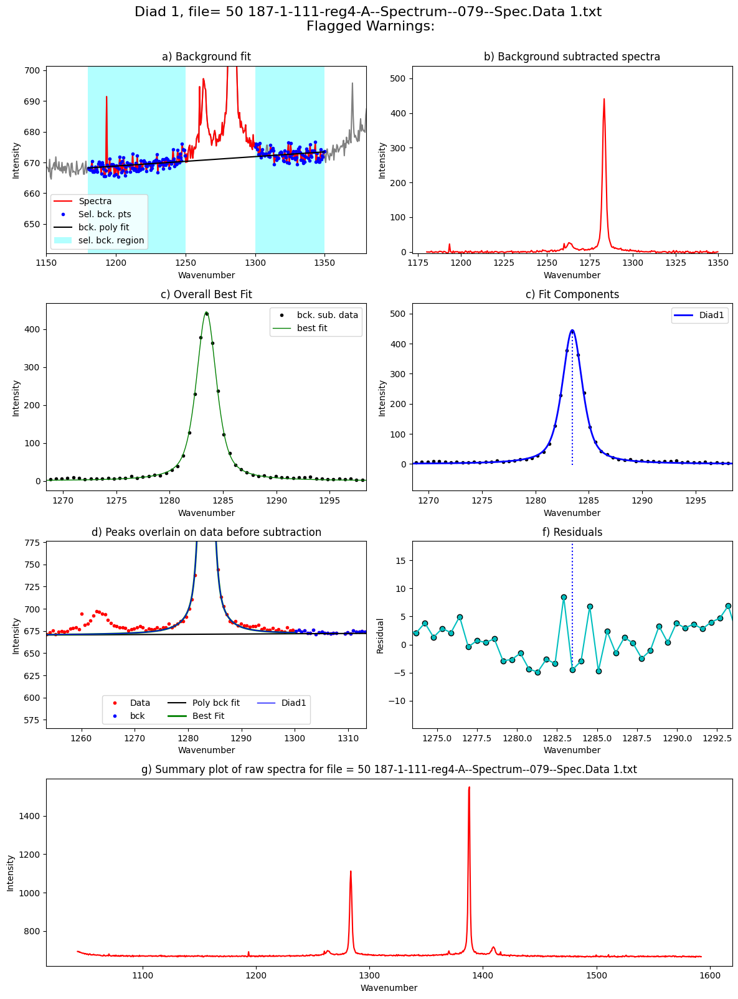

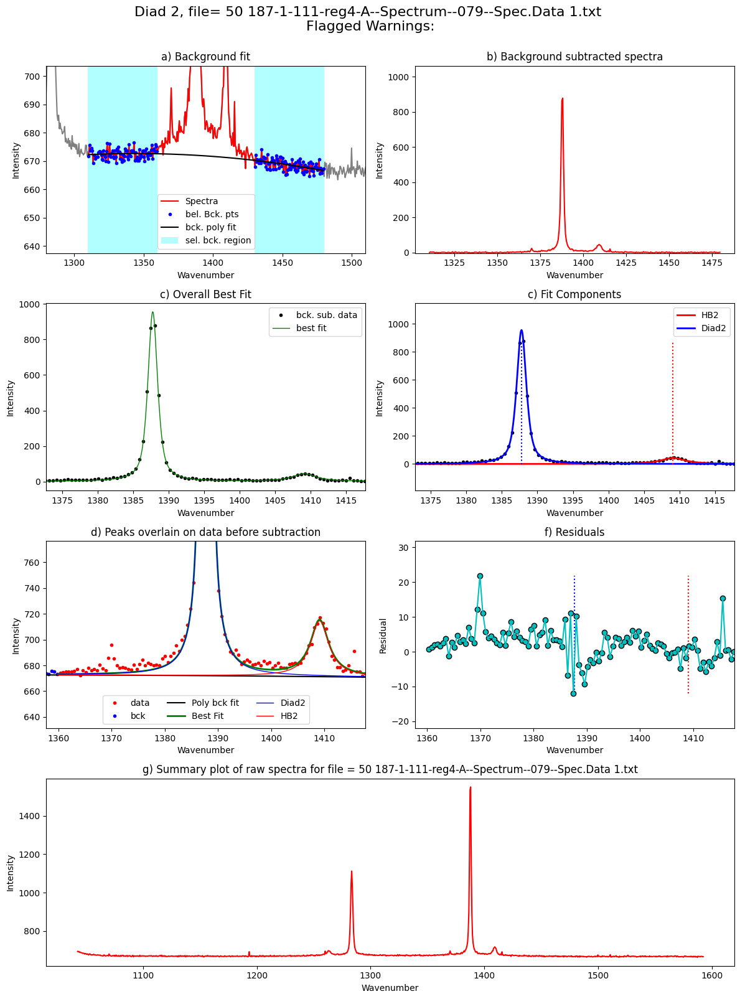

In [12]:
from tqdm import tqdm
plot_figure=True# If False, Means doesnt have to make figures, lot faster. 
close_figure=False # If True, wont show figures in notebook, but will still save them in a folder 
Diad_Files_i=Diad_Files
df_Merge = pd.DataFrame([])
for i in tqdm(range(0, len(Diad_Files))): #
    tqdm.write(f"Processing file: {Diad_Files[i]}")
    
    
    # For diad1, config file like you had in the previous. 
    # Only really used to exclude a range (say your spectra has a known spec)
    diad_id_config=pf.diad_id_config(exclude_range1=[1308, 1309])
    
    # Here, the prominence are taken from the fitting in the last notebook
    diad1_fit_config2.HB_prom=GroupN_df['HB1_abs_prom'].iloc[i]
    diad1_fit_config2.diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i]
    diad1_fit_config2.gauss_amp=2*GroupN_df['HB1_abs_prom'].iloc[i]

    Diad1_fit=pf.fit_diad_1_w_bck(config1=diad1_fit_config2,
    config2=diad_id_config, path=spectra_path, filename=GroupN_df['filename'].iloc[i],
    filetype=spectra_filetype, plot_figure=plot_figure, close_figure=close_figure,
    Diad_pos=GroupN_df['Diad1_pos'].iloc[i],
    HB_pos=GroupN_df['HB1_pos'].iloc[i])

    ## Same for diad2, just also has a C13 peak
    diad2_fit_config_init.HB_prom=GroupN_df['HB2_abs_prom'].iloc[i]
    diad2_fit_config_init.diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i]
    diad2_fit_config_init.gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i]
    diad2_fit_config_init.C13_prom=GroupN_df['C13_abs_prom'].iloc[i]
    
    
    Diad2_fit=pf.fit_diad_2_w_bck(config1=diad2_fit_config_init,
        config2=diad_id_config,
    path=spectra_path, filename=GroupN_df['filename'].iloc[i], 
    filetype=spectra_filetype,
    plot_figure=plot_figure, close_figure=close_figure,
    Diad_pos=GroupN_df['Diad2_pos'].iloc[i],
    HB_pos=GroupN_df['HB2_pos'].iloc[i], 
    C13_pos=GroupN_df['C13_pos'].iloc[i])
    
    # This combines the outputs into a single dataframe
    data=pf.combine_diad_outputs(filename=GroupN_df['filename'].iloc[i], prefix=prefix, 
    Diad1_fit=Diad1_fit, path=spectra_path,                  
    Diad2_fit=Diad2_fit)        
    
 

    df_Merge = pd.concat([df_Merge, data], axis=0).reset_index(drop=True)


In [13]:
# Save parameters to excel
combo=df_Merge

if batch=='Weak':
    combo.to_excel('Weak_Diads.xlsx', index=False)
if batch=='Medium':
    combo.to_excel('Medium_Diads.xlsx', index=False)
if batch=='Strong':
    combo.to_excel('Strong_Diads.xlsx', index=False)

In [14]:
combo

,filename,Splitting,Split_σ,Diad1_Combofit_Cent,Diad1_cent_err,Diad1_Combofit_Height,Diad1_Voigt_Cent,Diad1_Voigt_Area,Diad1_Voigt_Sigma,Diad1_Residual,...,Diad1_Asym50,Diad1_Asym70,Diad1_Yuan2017_sym_factor,Diad1_Remigi2021_BSF,Diad2_Asym50,Diad2_Asym70,Diad2_Yuan2017_sym_factor,Diad2_Remigi2021_BSF,Diad1_PDF_Model,Diad2_PDF_Model
0,187-1-110-A--Spectrum--009--Spec.Data 1_CRR_Di...,104.235139,0.014351,1283.717910,0.012908,151.526101,1283.717910,450.978847,1.067749,1.876613,...,1.033654,1.014574,0.071868,0.014093,1.087983,1.085627,0.142970,0.005170,PseudoVoigtModel,PseudoVoigtModel
1,187-1-110-A--Spectrum--010--Spec.Data 1_CRR_Di...,104.221639,0.016023,1283.733077,0.014620,136.028864,1283.733077,416.182645,1.134037,1.783855,...,1.041348,1.008457,0.093780,0.016673,1.100000,1.117005,0.161306,0.005397,PseudoVoigtModel,PseudoVoigtModel
2,187-1-110-A--Spectrum--011--Spec.Data 1_CRR_Di...,104.147419,0.016130,1283.806667,0.014720,125.334859,1283.806667,372.675137,1.076490,1.903475,...,1.276408,1.209536,0.595102,0.017178,1.079914,1.069909,0.128669,0.005904,PseudoVoigtModel,PseudoVoigtModel
3,187-1-110-B--Spectrum--014--Spec.Data 1_CRR_Di...,104.198932,0.008880,1283.737612,0.008431,397.918813,1283.737612,1195.442353,1.102616,4.200964,...,1.032357,1.011013,0.071356,0.005542,1.105495,1.095827,0.169048,0.001864,PseudoVoigtModel,PseudoVoigtModel
4,187-1-110-B--Spectrum--015--Spec.Data 1,104.216279,0.008781,1283.718863,0.008365,372.706593,1283.718863,1109.593795,1.079850,3.587974,...,1.021875,1.003319,0.047243,0.005795,1.071895,1.056748,0.114321,0.001964,PseudoVoigtModel,PseudoVoigtModel
5,187-1-110-B--Spectrum--016--Spec.Data 1,104.227089,0.009233,1283.705866,0.008758,338.243424,1283.705866,1032.567091,1.128606,3.219697,...,1.042553,1.022654,0.096052,0.006673,1.093886,1.100471,0.149893,0.002125,PseudoVoigtModel,PseudoVoigtModel
6,187-1-110-C--Spectrum--020--Spec.Data 1_CRR_Di...,104.196211,0.005019,1283.746363,0.004364,598.022532,1283.746413,1776.163139,1.106684,3.037365,...,1.024427,1.017738,0.054067,0.003701,1.087527,1.076805,0.139829,0.001258,PseudoVoigtModel,PseudoVoigtModel
7,187-1-110-C--Spectrum--021--Spec.Data 1_CRR_Di...,104.191895,0.004980,1283.732162,0.004324,631.360862,1283.732212,1874.722242,1.111265,2.973139,...,1.142857,1.105023,0.317504,0.003520,1.109865,1.101587,0.172498,0.001133,PseudoVoigtModel,PseudoVoigtModel
8,187-1-110-C--Spectrum--022--Spec.Data 1,104.206858,0.004851,1283.702851,0.004245,667.885635,1283.702901,1919.342891,1.070153,2.915136,...,1.094059,1.079347,0.201316,0.003205,1.110132,1.097826,0.176190,0.001144,PseudoVoigtModel,PseudoVoigtModel
9,187-1-111-reg1-A--Spectrum--031--Spec.Data 1_C...,103.493681,0.002963,1285.354769,0.002663,844.182067,1285.354819,1607.235549,0.698848,3.219252,...,1.111386,1.137931,0.155684,0.001656,1.118156,1.121145,0.132516,0.000695,PseudoVoigtModel,PseudoVoigtModel


### This plays a sound when the notebook is done if you have a tendency to procrastinate

In [15]:
# !pip install winotify

from winotify import Notification, audio

toast= Notification(app_id="VSCode",title="Notebook completed",
                    msg="Step3b_Secondary_Peaks is done!",
                    duration="short")
toast.set_audio(audio.Mail,loop=False)
toast.show()